In [2]:
# Train and Test different neural networks on spectrograms generated from the urbansound8k dataset
# Import inception model
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3
import keras
from keras.utils import load_img
from keras.utils import img_to_array


import time
import numpy as np
import os

In [2]:
# Ensure GPU Acceleration Enabled
import tensorflow as tf
from tensorflow.python.client import device_lib

print("\n\n\n")
print("Tensorflow GPU Test")
num_devices = tf.config.list_physical_devices('GPU')
print("Num GPUs Available: ", len(num_devices))
print(device_lib.list_local_devices())





Tensorflow GPU Test
Num GPUs Available:  1
[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 2883842064753305472
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 6269894656
locality {
  bus_id: 1
  links {
  }
}
incarnation: 10700039244307614445
physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 2070 SUPER, pci bus id: 0000:01:00.0, compute capability: 7.5"
xla_global_id: 416903419
]


In [3]:
import tensorflow as tf
print(tf.__version__)

2.10.0


In [4]:
# # Verify Database Exists

# # This is the directory of your image dataset as unzipped from the trainset_second.rar file.
# base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second'
       
# for i in range(1,11,1):
# #     path = os.path.join(dir_name, f"fold{i}")
#     path = os.path.join(base_dir,f"fold{i}_spectrograms-torch-1sec-nopad")
    
#     for j in range(0,10):
        
#         new_folder_path = os.path.join(path,f'{j}')
#         if os.path.isdir(new_folder_path) == False:
#             print(f"Error: Unexpected File Structure. Folder {new_folder_path} Does Not Exist.")
#         else:
#             print(f"Directory for fold{new_folder_path} exists.")

In [6]:
# Script Identifying Information

# Try number
try_num = 10

# base_model name
# recommended to ctrl-f back up here to make sure all the output files are named correctly
base_model_name = 'base_model_3_8_2023_sigmoid-try11-3'

# Experiment number 5
experiment_number = 5

In [5]:
# Good tutorial for building custom data generator
# https://vijayabhaskar96.medium.com/tutorial-image-classification-with-keras-flow-from-directory-and-generators-95f75ebe5720
# https://stanford.edu/~shervine/blog/keras-how-to-generate-data-on-the-fly

# Two Approaches to Merge datasets for CNN Tutorial
# https://stackoverflow.com/questions/60787620/combine-two-data-generator-to-train-a-cnn

In [16]:
# Choose merge datagen approach
# Create individual data generators

base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second'
generators_list = []

for i in range(1,11,1):
#     path = os.path.join(dir_name, f"fold{i}")
    path = os.path.join(base_dir,f"fold{i}_spectrograms-torch-1sec-nopad")
    img_arr = keras.utils.image_dataset_from_directory(path,
                                                   labels='inferred',
                                                   label_mode='categorical',
                                                   shuffle=False,
                                                   batch_size = 32,                                                  
                                                   image_size=(128, 128))
    generators_list.append(img_arr)

Found 3150 files belonging to 10 classes.
Found 3144 files belonging to 10 classes.
Found 3377 files belonging to 10 classes.
Found 3498 files belonging to 10 classes.
Found 3300 files belonging to 10 classes.
Found 2950 files belonging to 10 classes.
Found 3046 files belonging to 10 classes.
Found 2863 files belonging to 10 classes.
Found 2946 files belonging to 10 classes.
Found 3008 files belonging to 10 classes.


In [17]:
base_model_two = keras.models.load_model(os.path.join(base_dir, base_model_name))


In [18]:
# Create model outputs from generators
# -Run ML model on all sample_inputs from all generators
output_model_one = []
for elt in generators_list:
    output_gen = base_model_two.predict(elt)
    
    y_testt = np.concatenate([y for x, y in elt], axis=0)
    
    output_model_one.append([output_gen,y_testt])

94/94 [==============================] - 4s 41ms/step


In [3]:
# Save Model
import pickle
base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second'
with open(os.path.join(base_dir,"spring-2023_model_outputs"), "wb") as fp:
    pickle.dump(output_model_one, fp)

NameError: name 'output_model_one' is not defined

In [14]:
# Load Model

import pickle
base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second'
target_dir = os.path.join(base_dir,"spring-2023_model_outputs")

In [15]:

fp = open(target_dir, "rb")


In [16]:
output_model_one = pickle.load(fp)


EOFError: Ran out of input

In [32]:
print(len(output_model_one[0][0]))

3150


In [33]:
print(output_model_one[1][0])

[[3.2757699e-01 3.5474636e-04 1.9083087e-03 ... 2.9743942e-02
  2.0357338e-01 1.3705318e-05]
 [6.1856252e-01 2.4666147e-06 1.3896636e-03 ... 6.5749176e-02
  1.5643919e-04 4.1644516e-06]
 [6.7733270e-01 2.4559489e-04 4.0275801e-05 ... 1.9964173e-03
  1.4412781e-06 1.9237473e-04]
 ...
 [1.3165438e-04 4.2807067e-05 9.7878203e-02 ... 7.1158567e-08
  5.4821435e-06 9.8662448e-01]
 [2.7844211e-04 2.1174606e-05 4.7177202e-03 ... 1.8796178e-09
  2.5060542e-03 9.6975523e-01]
 [4.8140163e-04 3.2326032e-05 1.5963919e-01 ... 6.2323387e-08
  6.8771333e-05 8.1085908e-01]]


In [34]:
argmax_preds = []
for elt in output_model_one:
    for elt_i in range(len(elt[0])):
        argmax_preds.append([np.argmax(elt[0][elt_i]), np.argmax(elt[1][elt_i])])

In [35]:
print(argmax_preds)

[[5, 0], [4, 0], [0, 0], [0, 0], [5, 0], [5, 0], [5, 0], [5, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [5, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [5, 0], [5, 0], [0, 0], [0, 0], [5, 0], [0, 0], [5, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [5, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [5, 0], [0, 0], [5, 0], [5, 0], [5, 0], [5, 0], [5, 0], [0, 0], [0, 0], [0, 0], [0, 0], [5, 0], [0, 0], [5, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [5, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [5, 0], [0, 0], [5, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [5, 0], [0, 0], [5, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [2, 0], [5, 0], [5, 0], [5, 0], [5, 0], [5, 0], [5, 0], [9, 0], [9, 0], [7, 0], [0, 0], [7, 0], [0, 0], [9, 0], [5, 0], [9, 0], [5, 0], [7, 0], [9, 0], [7, 0], [9, 0], [9, 0],

In [36]:
output_gen_one = output_model_one

In [37]:
output_gen_one_labels = []
for i in range(len(output_gen_one)):
    output_gen_one_labels.append([np.argmax(output_gen_one[i]), np.argmax(y_testt[i])])

In [38]:
print(len(output_gen_one))
print(output_gen_one[0])

10
[array([[5.0549973e-02, 1.6545225e-07, 3.9231631e-06, ..., 1.4616241e-03,
        6.0291818e-06, 4.4365351e-07],
       [2.6173256e-02, 3.4739721e-06, 2.4774736e-05, ..., 4.0588283e-04,
        5.6017009e-03, 2.5948789e-06],
       [9.7273725e-01, 4.7415277e-04, 1.8163975e-06, ..., 2.8788642e-04,
        8.6976443e-06, 1.4763321e-04],
       ...,
       [9.3935793e-03, 3.1073272e-01, 2.8481378e-04, ..., 1.5513480e-04,
        1.9565346e-03, 7.3410678e-01],
       [7.2213300e-02, 5.4763740e-01, 9.8180678e-04, ..., 2.4707642e-04,
        1.0467048e-03, 9.3769562e-01],
       [9.5362123e-03, 7.1831057e-03, 7.0834946e-04, ..., 9.0873101e-07,
        1.5030748e-06, 9.9804914e-01]], dtype=float32), array([[1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.]], dtype=float32)]


In [39]:
ground_truth_fold_0 = generators_list[0]

In [40]:
y_testt = np.concatenate([y for x, y in generators_list[0]], axis=0)

In [41]:
print(output_gen_one_labels)

[[31500, 0], [25268, 0], [33770, 0], [30358, 0], [26388, 0], [29500, 0], [26428, 0], [28630, 0], [23668, 0], [23368, 0]]


In [42]:
num_correct = 0
num_incorrect = 0
num_total_sum = 0
for elt in argmax_preds:
    if (elt[0] == elt[1]):
        num_correct += 1
    elif (elt[0] != elt[1]):
        num_incorrect += 1
    num_total_sum += 1
print(num_correct)
print(num_incorrect)
print(num_total_sum)
percent_correct = 1.0*num_correct/num_total_sum
print(f"Percent Correct = {percent_correct}")

20967
10315
31282
Percent Correct = 0.670257656160092


In [43]:
TP = 0
FP = 0
num_total_sum = 0
for elt in argmax_preds:
    if (elt[0] == elt[1]):
        num_correct += 1
    elif (elt[0] != elt[1]):
        num_incorrect += 1
    num_total_sum += 1

In [44]:
percent_siren_correct = 0
percent_siren_incorrect = 0
num_total_siren = 0
for elt in argmax_preds:
    if (elt[1] == 8):
        num_total_siren += 1
        if (elt[0] == elt[1]):
            percent_siren_correct += 1
        elif (elt[0] != elt[1]):
            percent_siren_incorrect += 1
            
print(percent_siren_correct)
print(percent_siren_incorrect)
print(num_total_siren)
percent_correct = 1.0*percent_siren_correct/num_total_siren
print(f"Percent Siren Correct = {percent_correct}")          

2441
1190
3631
Percent Siren Correct = 0.6722665932250069


In [45]:
import sklearn
y_ground_truth = []
y_pred = []
for elt in argmax_preds:
    y_pred.append(elt[0])
    y_ground_truth.append(elt[1])

In [46]:
print(y_ground_truth)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [47]:
class_labels = ['air_conditioner',
                'car_horn',
                'children_playing',
                'dog_bark',
                'drilling',
                'engine_idling',
                'gun_shot',
                'jackhammer',
                'siren',
                'street_music']

In [48]:
# Create visualizations using sklearn metrics library

from sklearn.metrics import precision_score, PrecisionRecallDisplay

pres_model = precision_score(y_true = y_ground_truth, y_pred = y_pred, average = None)

print(pres_model)

[0.59130167 0.77924217 0.66063445 0.62217495 0.57249295 0.69248585
 0.67723343 0.76719057 0.87711103 0.67830803]


In [23]:
from sklearn.metrics import recall_score
recall_model = recall_score(y_true = y_ground_truth, y_pred = y_pred, average = None)

print(recall_model)

[0.47996995 0.43554328 0.78537079 0.74903969 0.81112696 0.68665476
 0.87523277 0.44186704 0.67226659 0.78175   ]


In [33]:
from sklearn.metrics import f1_score

f1_model = f1_score(y_ground_truth, y_pred, average=None)
print(f1_model)

[0.52985075 0.55877141 0.71762257 0.67973856 0.67123126 0.68955798
 0.76360682 0.56076108 0.76114749 0.72636469]


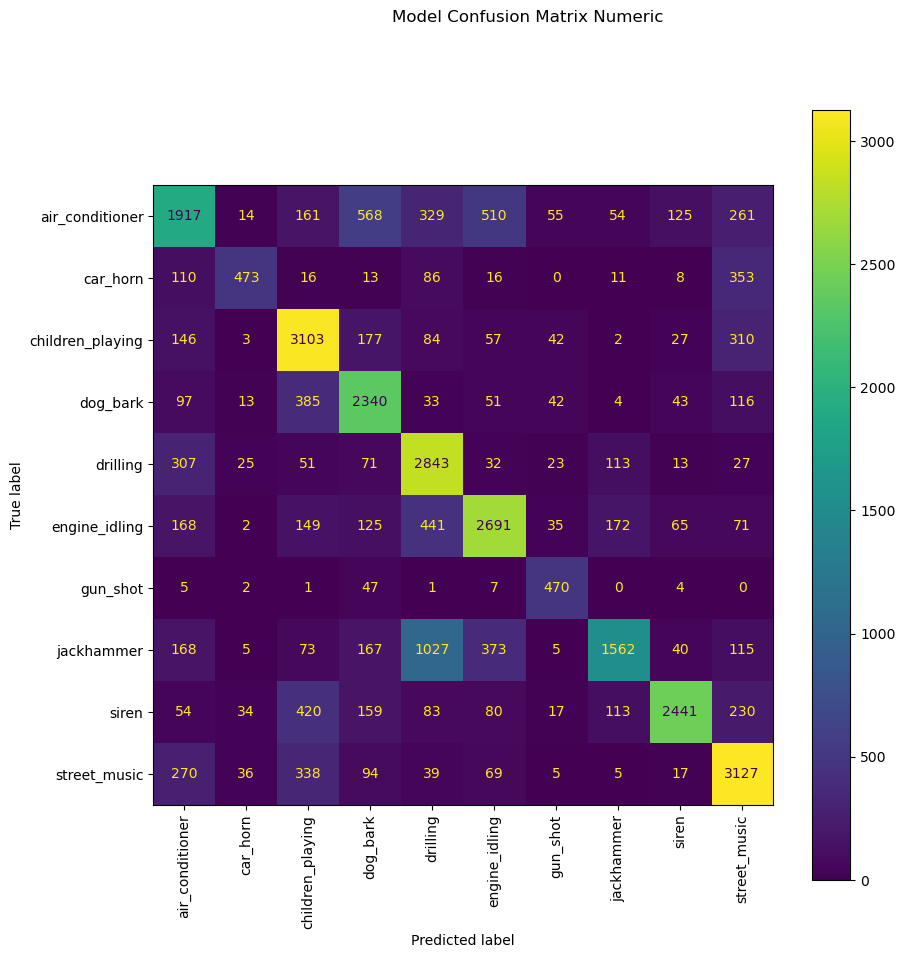

In [55]:
# Create visualizations using sklearn metrics library
# In absolute values
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
%matplotlib inline

conf_matrix = confusion_matrix(y_true=y_ground_truth, y_pred = y_pred, normalize=None)
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                              display_labels=class_labels)
disp.plot(xticks_rotation="vertical")
fig = disp.figure_

fig.set_figwidth(10)
fig.set_figheight(10) 
fig.axes[0].set
fig.suptitle('Model Confusion Matrix Numeric')



plt.show()

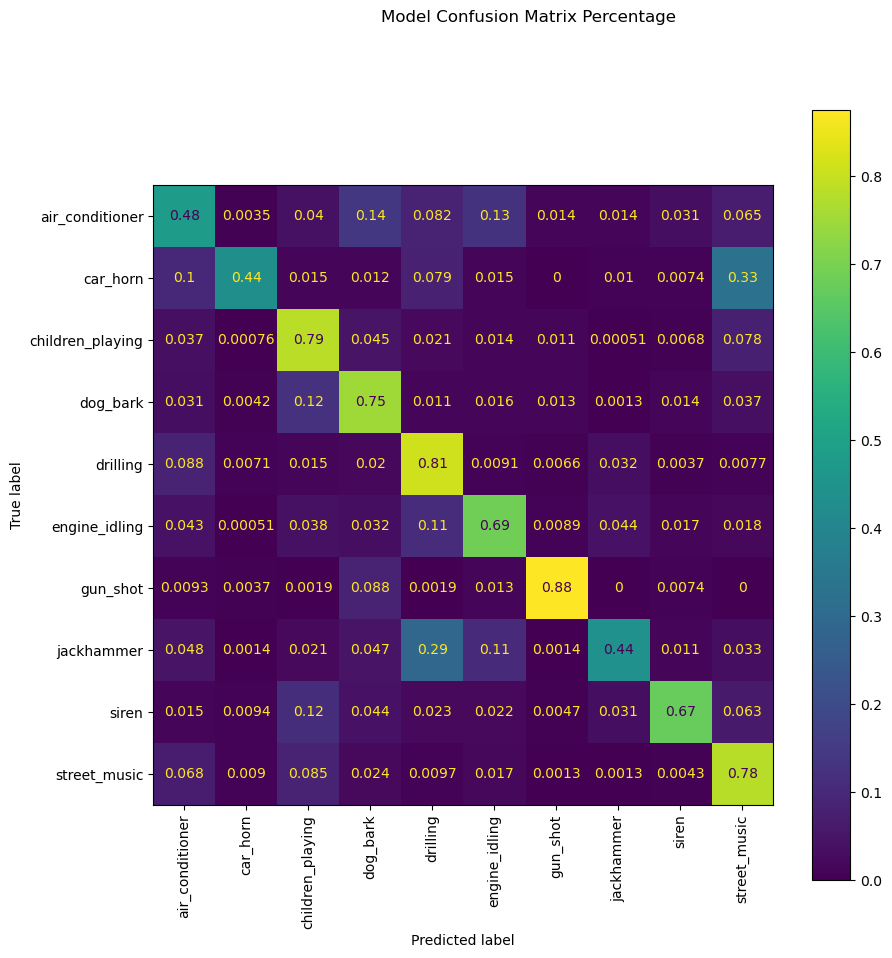

In [56]:
# Create visualizations using sklearn metrics library
# In percent
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
%matplotlib inline

conf_matrix = confusion_matrix(y_true=y_ground_truth, y_pred = y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                              display_labels=class_labels)
disp.plot(xticks_rotation="vertical")
fig = disp.figure_

fig.set_figwidth(10)
fig.set_figheight(10) 
fig.axes[0].set
fig.suptitle('Model Confusion Matrix Percentage')



plt.show()

In [9]:
print(generators_list[0].class_names)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']


In [7]:
# # Training weights:
# training_weight_dict_test = {}
# class_names = generators_list[0].class_names
# for elt_i in range(len(class_names)):
#     if class_names[elt_i] == '8':
#         training_weight_dict[elt_i] = 3
#     else:
#         training_weight_dict[elt_i] = 1

In [8]:
# print(training_weight_dict_test)

In [10]:
# Determine how to merge generators
# https://www.google.com/search?client=firefox-b-1-d&q=how+to+merge+2+image+dataset+generators+in+keras

# Model train/fit on batch
# Calling "fit" multiple times in Keras
# https://stackoverflow.com/questions/39263002/calling-fit-multiple-times-in-keras

# Keras tutorial for datasets too big to fit on memory
# https://keras.io/getting_started/faq/#how-can-i-use-keras-with-datasets-that-dont-fit-in-memory

# TODO Wrapper function to custom iterate through batches
# Train on batches from the training generator until there are no training batches left


def train_model_on_batches():
    return 0;
    
# Trains models across folds using the validation fold as validation
# Model fit generator was deprecated, can call the same thing with model.fit
# https://www.codesofinterest.com/2020/09/model-fit-vs-fit-generator-tfkeras.html
def train_across_folds(model, generators_list, validation_fold):
    
#     # Training weights:
#     training_weight_dict = {}
#     class_names = generators_list[0].class_names
#     for elt_i in range(len(class_names)):
#         if class_names[elt_i] == '8':
#             training_weight_dict[elt_i] = 3
#         else:
#             training_weight_dict[elt_i] = 1
            

    for elt_i in range(len(generators_list)):
        offset_i = elt_i + 1
        
        # Print Entering Loop
        if (offset_i == validation_fold):
            print(f"Skipping validation fold fold{offset_i}.")
            continue;
            
        else:
            print(f"Entering training loop for fold{offset_i}.")
            t_start = time.time()
            print(f"Time Start is: {t_start}.")
            model.fit(x = generators_list[elt_i], # Set train_x input as the generator at position elt_i 
                      batch_size = 32,  # The number of samples taken from the generator per iteration
                      epochs = 30, # Number of total runs on the dataset
                      verbose = 1, # For progress bar
                      validation_data = generators_list[validation_fold -1], # Set validation data as the target validation fold
                      #class_weight = training_weight_dict, # Use 3-1 class weighting for training
                      use_multiprocessing = True # Attempt to use multiprocessing
                     )
            print(f"End of fold{offset_i}.")
            t_end = time.time()-t_start
            print(f"Total Elapsed Time: {t_end}")
            

In [11]:
# Create pre-trained model:
# Build Pre-Trained Model
incepV3 = InceptionV3(input_shape = (128,128,3),
                                include_top = False, # Replace original classification head with new classification
                                                     # head that we will train for our use case (Urbansound8k)
                                weights = 'imagenet')

In [12]:
# Tensor Flow Tutorial 
# https://www.tensorflow.org/tutorials/images/transfer_learning

#https://medium.com/@1297rohit/transfer-learning-from-scratch-using-keras-339834b153b9
# https://stackoverflow.com/questions/66214588/adding-a-rescaling-layer-or-any-layer-for-that-matter-to-a-trained-tensorflow
inputs =  keras.Input(shape=(128, 128, 3))
inputs_scaled = keras.layers.Rescaling(1./255)(inputs) # Rescaling layer replaces default normalization layer pre-Tensorflow 2.10 tutorials.

x = incepV3(inputs_scaled, training=False)
pool = keras.layers.GlobalAveragePooling2D()(x) # Global pool to transform inceptionV3 model output (I'm not sure why this is absolutely necessary but it is)
outputs = keras.layers.Flatten()(pool) # Flatten output layers to a single dimension feature vector

# https://stats.stackexchange.com/questions/299292/dropout-makes-performance-worse
# outputs = tf.keras.layers.Dropout(.1)(outputs) # Dropout cannot be used at the end because model has no way to reconfigure
outputs = keras.layers.Dense(64, activation='relu')(outputs) # Modification relu hiddenlayer
outputs = keras.layers.Dense(10, activation='sigmoid')(outputs) # 10 node sigmoid output for multi-label classification problem

base_model = keras.Model(inputs=inputs, outputs=outputs)

In [13]:
# Try stochastic gradient descent from tutorial:
# https://stackoverflow.com/questions/37213388/keras-accuracy-does-not-change
from keras.optimizers import SGD
opt = SGD(learning_rate=0.0001)

base_model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['categorical_accuracy'])

In [14]:
base_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 128, 128, 3)       0         
                                                                 
 inception_v3 (Functional)   (None, 2, 2, 2048)        21802784  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 flatten (Flatten)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 64)                131136    
                                                             

In [13]:
# Experiment History:
# tried dropout = .2  did not work
# Dropout can work but it will produce distorted numbers during training when it is randomly masking different neurons
# In validation/prediction this layer will not activate and therefore a model can perform better on validation
# if it is using dropout.

# https://stackoverflow.com/questions/47787011/how-to-disable-dropout-while-prediction-in-keras

# https://stats.stackexchange.com/questions/272607/cifar-10-cant-get-above-60-accuracy-keras-with-tensorflow-backend
# "Based on the updated plots in the question, the most obvious problem that is demonstrated is overfitting.
# This is evidenced by the divergence of the train-test data after about the 15th epoch which demonstrates 
# insufficient regularization for this architecture, for this data set. You will be unlikely to get 
# improvement from tuning any other hyperparameters (normalization strategies, learning rates, etc.) unless 
# the overfitting is addressed.""

# Many large company models use dropout even near the end
# It may have to do with the fact that their dataset is larger and they can maintain a very low learning rate

# Keras dropout tutorial
# https://keras.io/api/layers/regularization_layers/dropout/

# adam optimizer may not be the correct choice
# https://opt-ml.org/papers/2021/paper53.pdf


# trying https://stackoverflow.com/questions/37213388/keras-accuracy-does-not-change
# SGD optimizer with 0.001 (0.01 recommended)

# Model was decreasing in accuracy with number of epochs, this means training rate could be too high
# try for training_rate = training_rate/10

# Cross entropy loss function
# All multiclass loss explained 
# https://stackoverflow.com/questions/44674847/what-are-the-differences-between-all-these-cross-entropy-losses-in-keras-and-ten

# cross vs sparse entropy comparison
# https://stats.stackexchange.com/questions/326065/cross-entropy-vs-sparse-cross-entropy-when-to-use-one-over-the-other
# * good source * https://datascience.stackexchange.com/questions/41921/sparse-categorical-crossentropy-vs-categorical-crossentropy-keras-accuracy
# google keras nonsparse vs sparse
# 

# New try:
# Correct binary cross entropy error
# use categorical_crossentropy
# https://www.google.com/search?client=firefox-b-1-d&q=binary_crossentropy+vs+categorical_crossentropy
# https://stackoverflow.com/questions/42081257/why-binary-crossentropy-and-categorical-crossentropy-give-different-performances

In [ ]:
# Entropy guide:
# https://stackoverflow.com/questions/42081257/why-binary-crossentropy-and-categorical-crossentropy-give-different-performances/44498955#44498955

# a simple example under a multi-class setting to illustrate

# suppose you have 4 classes (onehot encoded) and below is just one prediction

# true_label = [0,1,0,0] predicted_label = [0,0,1,0]

# when using categorical_crossentropy, the accuracy is just 0 , it only cares about if you get the concerned class right.

# however when using binary_crossentropy, the accuracy is calculated for all classes, it would be 50% for this prediction. and the final result will be the mean of the individual accuracies for both cases.

# it is recommended to use categorical_crossentropy for multi-class(classes are mutually exclusive) problem but binary_crossentropy for multi-label problem.


In [ ]:
# More entropy guide
# https://towardsdatascience.com/cross-entropy-classification-losses-no-math-few-stories-lots-of-intuition-d56f8c7f06b0

In [26]:
print(type(generators_list[0]))

<class 'tensorflow.python.data.ops.dataset_ops.BatchDataset'>


In [12]:
train_across_folds(base_model, generators_list = generators_list, validation_fold=10)

Entering training loop for fold1.
Time Start is: 1678272027.6053052.
Epoch 1/30
99/99 [==============================] - 23s 150ms/step - loss: 0.5883 - categorical_accuracy: 0.1292 - val_loss: 0.4411 - val_categorical_accuracy: 0.1154
Epoch 2/30
99/99 [==============================] - 11s 112ms/step - loss: 0.3695 - categorical_accuracy: 0.2098 - val_loss: 0.3495 - val_categorical_accuracy: 0.1582
Epoch 3/30
99/99 [==============================] - 11s 113ms/step - loss: 0.3059 - categorical_accuracy: 0.2968 - val_loss: 0.3171 - val_categorical_accuracy: 0.2477
Epoch 4/30
99/99 [==============================] - 11s 111ms/step - loss: 0.2755 - categorical_accuracy: 0.4029 - val_loss: 0.3011 - val_categorical_accuracy: 0.3005
Epoch 5/30
99/99 [==============================] - 12s 122ms/step - loss: 0.2554 - categorical_accuracy: 0.4698 - val_loss: 0.2908 - val_categorical_accuracy: 0.3354
Epoch 6/30
99/99 [==============================] - 12s 117ms/step - loss: 0.2395 - categorical_

Epoch 19/30
99/99 [==============================] - 11s 111ms/step - loss: 0.0861 - categorical_accuracy: 0.8709 - val_loss: 0.2142 - val_categorical_accuracy: 0.5991
Epoch 20/30
99/99 [==============================] - 12s 121ms/step - loss: 0.0833 - categorical_accuracy: 0.8756 - val_loss: 0.2168 - val_categorical_accuracy: 0.5971
Epoch 21/30
99/99 [==============================] - 12s 117ms/step - loss: 0.0807 - categorical_accuracy: 0.8807 - val_loss: 0.2175 - val_categorical_accuracy: 0.5964
Epoch 22/30
99/99 [==============================] - 11s 111ms/step - loss: 0.0783 - categorical_accuracy: 0.8852 - val_loss: 0.2182 - val_categorical_accuracy: 0.5977
Epoch 23/30
99/99 [==============================] - 12s 120ms/step - loss: 0.0762 - categorical_accuracy: 0.8877 - val_loss: 0.2152 - val_categorical_accuracy: 0.6027
Epoch 24/30
99/99 [==============================] - 11s 112ms/step - loss: 0.0739 - categorical_accuracy: 0.8934 - val_loss: 0.2172 - val_categorical_accuracy:

Epoch 6/30
110/110 [==============================] - 13s 114ms/step - loss: 0.1088 - categorical_accuracy: 0.8030 - val_loss: 0.1964 - val_categorical_accuracy: 0.6406
Epoch 7/30
110/110 [==============================] - 12s 108ms/step - loss: 0.1025 - categorical_accuracy: 0.8193 - val_loss: 0.1957 - val_categorical_accuracy: 0.6449
Epoch 8/30
110/110 [==============================] - 13s 114ms/step - loss: 0.0971 - categorical_accuracy: 0.8342 - val_loss: 0.1925 - val_categorical_accuracy: 0.6496
Epoch 9/30
110/110 [==============================] - 13s 118ms/step - loss: 0.0923 - categorical_accuracy: 0.8451 - val_loss: 0.1952 - val_categorical_accuracy: 0.6446
Epoch 10/30
110/110 [==============================] - 12s 109ms/step - loss: 0.0881 - categorical_accuracy: 0.8522 - val_loss: 0.1924 - val_categorical_accuracy: 0.6556
Epoch 11/30
110/110 [==============================] - 12s 113ms/step - loss: 0.0842 - categorical_accuracy: 0.8642 - val_loss: 0.1917 - val_categorical_a

96/96 [==============================] - 12s 122ms/step - loss: 0.0612 - categorical_accuracy: 0.9041 - val_loss: 0.1996 - val_categorical_accuracy: 0.6519
Epoch 11/30
96/96 [==============================] - 11s 111ms/step - loss: 0.0581 - categorical_accuracy: 0.9114 - val_loss: 0.2004 - val_categorical_accuracy: 0.6486
Epoch 12/30
96/96 [==============================] - 11s 116ms/step - loss: 0.0552 - categorical_accuracy: 0.9186 - val_loss: 0.2005 - val_categorical_accuracy: 0.6523
Epoch 13/30
96/96 [==============================] - 11s 111ms/step - loss: 0.0527 - categorical_accuracy: 0.9202 - val_loss: 0.2024 - val_categorical_accuracy: 0.6473
Epoch 14/30
96/96 [==============================] - 12s 120ms/step - loss: 0.0503 - categorical_accuracy: 0.9297 - val_loss: 0.2040 - val_categorical_accuracy: 0.6439
Epoch 15/30
96/96 [==============================] - 11s 111ms/step - loss: 0.0483 - categorical_accuracy: 0.9301 - val_loss: 0.1983 - val_categorical_accuracy: 0.6586
Epoc

In [13]:
# Experiment 4
# Can try method to randomly sample test set from sirens as validation instead of
# all 10 classes in fold 10

# Try categorical crossentropy
# metrics categorical accuracy

# https://www.linkedin.com/pulse/100-accuracy-supremacy-imperfection-overfitting-vs-utkarsh-sharma/

# https://stackoverflow.com/questions/63233330/training-accuracy-100-percent-and-validation-accuracy-not-changing

In [ ]:
# Worked on automating test harness and printing a decent grid output for model outputs

In [ ]:
# https://stackoverflow.com/questions/57976730/keras-multiclass-classification-dense-model-confusion-matrix-incorrect
# Next, determine how to create confusion matrix

# Tutorial on creating confusion matrices
# https://www.kdnuggets.com/2021/02/evaluating-deep-learning-models-confusion-matrix-accuracy-precision-recall.html

# random tutorial:
# https://subscription.packtpub.com/book/big-data-and-business-intelligence/9781838555078/6/ch06lvl1sec34/confusion-matrix
# https://www.kaggle.com/code/mdmashurshalehin/plotting-confusion-matrix-for-tensorflow-model

In [ ]:
# Next, experiment with different layer types
# https://towardsdatascience.com/a-comprehensible-explanation-of-the-dimensions-in-cnns-841dba49df5e

# Good stack exchange:
# https://datascience.stackexchange.com/questions/22760/number-and-size-of-dense-layers-in-a-cnn

# Cambridge's tutorial:
# https://lipyeow.github.io/ics491f17/morea/deepnn/ImageClassification-CNN.pdf

In [ ]:
# Next, determine if class weights can improve classification accuracy on our target class
# https://datascience.stackexchange.com/questions/13490/how-to-set-class-weights-for-imbalanced-classes-in-keras

# Next, use 1 vs all sigmoid:
# https://developers.google.com/machine-learning/crash-course/multi-class-neural-networks/one-vs-all

# More multiclass links:
# https://stackoverflow.com/questions/44164749/how-does-keras-handle-multilabel-classification

In [ ]:
# Full premade program links for transfer learning on urbansound8k:
# https://medium.com/deepdeploy/transfer-learning-for-sound-classification-c9696c931f7d
# Sonar example https://machinelearningmastery.com/dropout-regularization-deep-learning-models-keras/
# Benchmarks for all models
# *** https://paperswithcode.com/sota/environmental-sound-classification-on

# Next try to learn attributes of keras dataset
# Dataset tutorial:
# https://www.tensorflow.org/guide/data#dataset_structure

# Next try:
# Training with a curriculum:
# https://datascience.stackexchange.com/questions/31129/sample-importance-training-weights-in-keras

# Next try to make a better report by plotting a table of images and text in plt:
# https://www.tutorialspoint.com/how-do-i-plot-only-a-table-in-matplotlib

# Good overfit tutorial question:
# https://stats.stackexchange.com/questions/418868/100-accuracy-on-training-high-accuracy-on-testing-as-well-what-does-this-mean
# Proceed to google: https://www.google.com/search?client=firefox-b-1-d&q=getting+to+100%25+test+accuracy+in+very+few+epochs
# https://stats.stackexchange.com/questions/258166/good-accuracy-despite-high-loss-value

In [ ]:
# Experiment 5 - THE CURRENT EXPERIMENT - 
# Construct proper test harness and model
# Try randomized batch input but not random folds
# Try sigmoid activation function for multi-label classification
#  Potentially characterize this as a semi-supervised learning problem where we have 1 of n unknown classes
#  provided and up to 10 other classes in the sample
#  
# Epoch number = 30
# Optimizer = SGD
# Learning Rate = 0.0001
# Weights = Uniform
# Loss function = binary_crossentropy
# accuracy_metric = categorical accuracy

# Supposedly using binary_accuracy is still okay but categorical_accuracy should be tried
# https://stackoverflow.com/questions/53874485/multi-label-classification-keras-metrics

# Supposedly using binary_accuracy is not okay categorical_accuracy is the only correct metric
# https://stats.stackexchange.com/questions/285255/nns-multiple-sigmoid-binary-cross-entropy-giving-better-results-than-softmax

# Neither binary nor categorical accuracy is best, use AUROC or area under receiver operating charateristic curve
# in zotero

# Trying categorical

In [ ]:
# Next try hyperbolic tangent tanh
# https://www.baeldung.com/cs/sigmoid-vs-tanh-functions

In [14]:
# Directory for test image
test_img_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second\fold10_spectrograms-torch-1sec-nopad\8'
test_img_fp = r'26173-8-0-0-melspec-torch-0.png'
test_path = os.path.join(test_img_dir,test_img_fp)

test_img = tf.keras.utils.load_img(test_path, target_size=(128, 128))
test_img_array = tf.keras.utils.img_to_array(test_img)
test_img_array = tf.expand_dims(test_img_array, 0)
prediction = base_model.predict(test_img_array)

1/1 [==============================] - 2s 2s/step


In [15]:
def get_prediction(test_path):
    test_img = tf.keras.utils.load_img(test_path, target_size=(128, 128))
    test_img_array = tf.keras.utils.img_to_array(test_img)
    test_img_array = tf.expand_dims(test_img_array, 0)
    prediction = base_model.predict(test_img_array)
    return prediction

In [16]:
print("np.argmax(prediction) is: ", str(np.argmax(prediction)))

np.argmax(prediction) is:  8


In [17]:
print(len(prediction[0]))

10


In [18]:
# indices = np.arange(len(prediction[0]))
# print(indices)

[0 1 2 3 4 5 6 7 8 9]


In [ ]:
indices = np.arange(len(prediction[0]))
print(prediction)

In [20]:
for elt_i in range(len(prediction[0])):
    
    print('\n')
    print(f"class {elt_i} , pr(class) = {prediction[0][elt_i]} \n")



class 0 , pr(class) = 0.0006898357532918453 



class 1 , pr(class) = 1.3622732240037294e-06 



class 2 , pr(class) = 0.2865387499332428 



class 3 , pr(class) = 3.739583689821302e-06 



class 4 , pr(class) = 6.010249080645735e-07 



class 5 , pr(class) = 0.002463970333337784 



class 6 , pr(class) = 7.980136729202059e-08 



class 7 , pr(class) = 7.839536237952416e-07 



class 8 , pr(class) = 0.9991827607154846 



class 9 , pr(class) = 2.099261990906598e-07 



In [ ]:
print(prediction[0])

In [2]:
# This is the directory of your image dataset as unzipped from the trainset_second.rar file.
base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second'

# Save the model
save_path = os.path.join(base_dir, 'base_model_3_8_2023_sigmoid-try11-2')
# base_model.save(save_path, save_format='h5')

# Load the model
base_model = keras.models.load_model(save_path)


In [3]:
# Directory of spectrograms to be tested.
# Replace the '8' with any other class to test another folder
# Replace 'fold10' with another fold to test another fold

os.chdir(r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second\fold10_spectrograms-torch-1sec-nopad\8')

In [4]:
file_list = os.listdir()

In [5]:
print(len(file_list))

315


In [63]:
# # Check all spectrograms in target folder
# test_siren_fold_ten = []
# base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second\fold10_spectrograms-torch-1sec-nopad\8'
# fold_name = 10

# error_arr = []
# success_arr = []
# for elt in file_list:
#     if elt[-4:] != '.png':
#         continue;
#     else:
#         target_path = os.path.join(base_dir, elt)
#         temp = get_prediction(target_path)
        
        
#         if np.argmax(temp) != 8:
#             error_arr.append((np.argmax(temp), elt))
#         elif np.argmax(temp) == 8:
#             success_arr.append((np.argmax(temp), elt))

#         # Inline delete to get the top 3
            
#         test_siren_fold_ten.append(np.argmax(temp))

#         print(np.argmax(temp))
        

1/1 [==============================] - 1s 960ms/step
8
1/1 [==============================] - 0s 22ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 16ms/step
8
1/1 [==============================] - 0s 38ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 38ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 16ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 22ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 22ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [======================

1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 38ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 16ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 16ms/step
6
1/1 [==============================] - 0s 22ms/step
8
1/1 [==============================] - 0s 16ms/step
6
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 22ms/step
8


In [23]:
def get_prediction(test_path):
    test_img = tf.keras.utils.load_img(test_path, target_size=(128, 128))
    test_img_array = tf.keras.utils.img_to_array(test_img)
    test_img_array = tf.expand_dims(test_img_array, 0)
    prediction = base_model.predict(test_img_array)
    return prediction

In [15]:
def predict_folder(base_dir, file_list, target_class):
    # Check all spectrograms in target folder
    test_siren_fold_ten = []
    

    fold_name = 10

    error_arr = []
    success_arr = []
    for elt in file_list:
        if elt[-4:] != '.png':
            continue;
        else:
            target_path = os.path.join(base_dir, elt)
            temp = get_prediction(target_path)
            
#             for i in range(3):
#                 temp_top_k.append(np.argmax(temp))
                
            if np.argmax(temp) != target_class:
                error_arr.append((temp, elt))
            elif np.argmax(temp) == target_class:
                success_arr.append((temp, elt))

            # Inline delete to get the top 3

            test_siren_fold_ten.append(np.argmax(temp))

            print(np.argmax(temp))
    return test_siren_fold_ten, error_arr, success_arr

In [25]:
def predict_folder_neutral(base_dir, file_list):
    # Check all spectrograms in target folder
    test_fold_output = []
    model_output = []
#     file_list = os.listdir(base_dir)
    
    # save_path = os.path.join(base_dir, 'base_model_3_8_2023_sigmoid-try11-1')
    
    for i in range(10):
        fold_name = i
        
        folder_path = os.path.join(base_dir, f'{i}')
        file_list = os.listdir(folder_path)
        
        for elt in file_list:
            if elt[-4:] != '.png':
                continue;
            else:
                target_path = os.path.join(folder_path, elt)
                temp = get_prediction(target_path)
                temp_ground_truth = i

                # Inline delete to get the top 3

                test_fold_output.append([np.argmax(temp), i])

                print(np.argmax(temp))
    return model_output, test_fold_output

In [44]:
folder_path = os.path.join(base_dir, "0")
file_list = os.listdir(folder_path)
print(file_list)

['119067-0-0-0-melspec-torch-0.png', '119067-0-0-0-melspec-torch-1.png', '119067-0-0-0-melspec-torch-2.png', '119067-0-0-0-melspec-torch-3.png', '119067-0-0-1-melspec-torch-0.png', '119067-0-0-1-melspec-torch-1.png', '119067-0-0-1-melspec-torch-2.png', '119067-0-0-1-melspec-torch-3.png', '119067-0-0-2-melspec-torch-0.png', '119067-0-0-2-melspec-torch-1.png', '119067-0-0-2-melspec-torch-2.png', '119067-0-0-2-melspec-torch-3.png', '167464-0-0-0-melspec-torch-0.png', '167464-0-0-0-melspec-torch-1.png', '167464-0-0-0-melspec-torch-2.png', '167464-0-0-0-melspec-torch-3.png', '167464-0-0-1-melspec-torch-0.png', '167464-0-0-1-melspec-torch-1.png', '167464-0-0-1-melspec-torch-2.png', '167464-0-0-1-melspec-torch-3.png', '167464-0-0-10-melspec-torch-0.png', '167464-0-0-10-melspec-torch-1.png', '167464-0-0-10-melspec-torch-2.png', '167464-0-0-10-melspec-torch-3.png', '167464-0-0-11-melspec-torch-0.png', '167464-0-0-11-melspec-torch-1.png', '167464-0-0-11-melspec-torch-2.png', '167464-0-0-11-melsp

In [35]:
# base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second\fold10_spectrograms-torch-1sec-nopad\8'



base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second\fold10_spectrograms-torch-1sec-nopad'
os.chdir(base_dir)
file_list = os.listdir()

# target class
target_class = 8
model_output_outer, test_fold_output_outer = predict_folder_neutral(base_dir, file_list)

1/1 [==============================] - 0s 53ms/step
7
1/1 [==============================] - 0s 27ms/step
0
1/1 [==============================] - 0s 26ms/step
5
1/1 [==============================] - 0s 28ms/step
0
1/1 [==============================] - 0s 30ms/step
5
1/1 [==============================] - 0s 27ms/step
0
1/1 [==============================] - 0s 27ms/step
0
1/1 [==============================] - 0s 28ms/step
0
1/1 [==============================] - 0s 28ms/step
0
1/1 [==============================] - 0s 26ms/step
0
1/1 [==============================] - 0s 28ms/step
0
1/1 [==============================] - 0s 31ms/step
8
1/1 [==============================] - 0s 27ms/step
6
1/1 [==============================] - 0s 27ms/step
8
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 28ms/step
6
1/1 [==============================] - 0s 25ms/step
6
1/1 [==============================] - 0s 28ms/step
6
1/1 [=======================

1/1 [==============================] - 0s 24ms/step
8
1/1 [==============================] - 0s 28ms/step
5
1/1 [==============================] - 0s 27ms/step
2
1/1 [==============================] - 0s 28ms/step
9
1/1 [==============================] - 0s 28ms/step
6
1/1 [==============================] - 0s 28ms/step
5
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 29ms/step
8
1/1 [==============================] - 0s 24ms/step
8
1/1 [==============================] - 0s 24ms/step
6
1/1 [==============================] - 0s 27ms/step
5
1/1 [==============================] - 0s 28ms/step
9
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 26ms/step
0
1/1 [==============================] - 0s 24ms/step
6
1/1 [==============================] - 0s 30ms/step
6
1/1 [==============================] - 0s 31ms/step
6
1/1 [=======================

1/1 [==============================] - 0s 25ms/step
6
1/1 [==============================] - 0s 26ms/step
5
1/1 [==============================] - 0s 25ms/step
9
1/1 [==============================] - 0s 25ms/step
0
1/1 [==============================] - 0s 26ms/step
7
1/1 [==============================] - 0s 29ms/step
6
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 26ms/step
9
1/1 [==============================] - 0s 27ms/step
6
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 25ms/step
7
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 24ms/step
6
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 25ms/step
2
1/1 [==============================] - 0s 26ms/step
7
1/1 [==============================] - 0s 25ms/step
5
1/1 [=======================

1/1 [==============================] - 0s 24ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 31ms/step
5
1/1 [==============================] - 0s 24ms/step
8
1/1 [==============================] - 0s 24ms/step
4
1/1 [==============================] - 0s 24ms/step
8
1/1 [==============================] - 0s 24ms/step
0
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 24ms/step
7
1/1 [==============================] - 0s 24ms/step
4
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 24ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 24ms/step
2
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 26ms/step
0
1/1 [=======================

1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 26ms/step
5
1/1 [==============================] - 0s 26ms/step
4
1/1 [==============================] - 0s 27ms/step
8
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 25ms/step
6
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 27ms/step
6
1/1 [==============================] - 0s 26ms/step
5
1/1 [==============================] - 0s 26ms/step
2
1/1 [==============================] - 0s 26ms/step
5
1/1 [==============================] - 0s 28ms/step
2
1/1 [==============================] - 0s 30ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 27ms/step
8
1/1 [==============================] - 0s 27ms/step
8
1/1 [=======================

1/1 [==============================] - 0s 25ms/step
4
1/1 [==============================] - 0s 26ms/step
5
1/1 [==============================] - 0s 27ms/step
4
1/1 [==============================] - 0s 28ms/step
5
1/1 [==============================] - 0s 25ms/step
0
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 26ms/step
4
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 27ms/step
7
1/1 [==============================] - 0s 26ms/step
7
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 27ms/step
5
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 26ms/step
5
1/1 [==============================] - 0s 26ms/step
0
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 25ms/step
0
1/1 [=======================

1/1 [==============================] - 0s 27ms/step
8
1/1 [==============================] - 0s 27ms/step
8
1/1 [==============================] - 0s 27ms/step
6
1/1 [==============================] - 0s 28ms/step
7
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 26ms/step
7
1/1 [==============================] - 0s 30ms/step
7
1/1 [==============================] - 0s 25ms/step
4
1/1 [==============================] - 0s 25ms/step
7
1/1 [==============================] - 0s 28ms/step
4
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 25ms/step
7
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 25ms/step
7
1/1 [=======================

1/1 [==============================] - 0s 26ms/step
4
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 26ms/step
4
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 30ms/step
4
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 30ms/step
4
1/1 [==============================] - 0s 26ms/step
4
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 27ms/step
0
1/1 [==============================] - 0s 27ms/step
4
1/1 [==============================] - 0s 25ms/step
4
1/1 [==============================] - 0s 27ms/step
8
1/1 [==============================] - 0s 29ms/step
4
1/1 [==============================] - 0s 25ms/step
8
1/1 [=======================

1/1 [==============================] - 0s 26ms/step
4
1/1 [==============================] - 0s 25ms/step
2
1/1 [==============================] - 0s 32ms/step
4
1/1 [==============================] - 0s 25ms/step
2
1/1 [==============================] - 0s 27ms/step
2
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 24ms/step
5
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 26ms/step
2
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 27ms/step
2
1/1 [==============================] - 0s 27ms/step
8
1/1 [==============================] - 0s 29ms/step
8
1/1 [==============================] - 0s 27ms/step
8
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 28ms/step
8
1/1 [==============================] - 0s 28ms/step
6
1/1 [==============================] - 0s 25ms/step
9
1/1 [=======================

1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 27ms/step
0
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 29ms/step
8
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 29ms/step
2
1/1 [==============================] - 0s 29ms/step
5
1/1 [==============================] - 0s 26ms/step
9
1/1 [==============================] - 0s 26ms/step
8
1/1 [==============================] - 0s 29ms/step
6
1/1 [==============================] - 0s 28ms/step
0
1/1 [==============================] - 0s 26ms/step
6
1/1 [==============================] - 0s 25ms/step
8
1/1 [==============================] - 0s 26ms/step
9
1/1 [=======================

In [36]:
print(len(test_fold_output_outer))

3008


In [37]:
print(test_fold_output_outer[0])

[7, 0]


In [38]:
type(test_fold_output_outer[0])

list

In [39]:
import pickle

with open("fold10-1_model_outputs", "wb") as fp:
    pickle.dump(test_fold_output_outer, fp)

In [40]:
for i in range(10):
    print(test_fold_output_outer[i])

[7, 0]
[0, 0]
[5, 0]
[0, 0]
[5, 0]
[0, 0]
[0, 0]
[0, 0]
[0, 0]
[0, 0]


In [41]:
num_correct = 0
num_incorrect = 0
num_total_sum = 0
for elt in test_fold_output_outer:
    if (elt[0] == elt[1]):
        num_correct += 1
    elif (elt[0] != elt[1]):
        num_incorrect += 1
    num_total_sum += 1
print(num_correct)
print(num_incorrect)
print(num_total_sum)

289
2719
3008


In [99]:
print(len(file_list))

315


In [100]:
# Calculate num correct and probability
num_correct = len(test_siren_fold_ten) - len(error_array)
total_length = len(test_siren_fold_ten)

In [101]:
print("Test num correct: ", num_correct)

Test num correct:  200


In [102]:
print("Test percent correct: ", str(num_correct/total_length))

Test percent correct:  0.6349206349206349


In [14]:
def process_output_array(output_array):
    ret_array = []
    for elt in output_array:
        # Range over the indexes in the probability output vectors
        # elt in output_array is of form ( (prediction vectors), (filenames) )
        temp = []
        for elt_i in range(len(elt[0][0])):
            # Append indicies and predictions as a tuple (index, prediction) and 
            temp.append((elt_i, elt[0][0][elt_i]))
    #         print(f"Appending {(elt_i, elt[0][0][elt_i])}")
    #         print("Temp is: ")
    #         print(temp)
        # Append modified prediction array with filename

    #     print(f"Outer append is: {(temp, elt[1])}")
        ret_array.append((temp, elt[1]))
    
    
    return ret_array

In [15]:
def sort_processed_output_array(processed_output_array):

    processed_output_array_sorted = []
    for elt in processed_output_array:
        temp_x = elt[0]
        temp_x.sort(key = lambda x: x[1])
        temp_xy = (temp_x, elt[1])
        processed_output_array_sorted.append(temp_xy)
    return processed_output_array_sorted

In [75]:
from PIL import Image
def create_output_img_array(output_array_sorted):
    # Plot every image in a folder with plt
    # https://stackoverflow.com/questions/55971214/plotting-every-image-from-a-folder

    # Create error image array
    output_images_temp = []
#     success_images  = []
    for elt in output_array_sorted:
        output_images_temp.append(np.asarray(Image.open(os.path.join(base_dir, elt[1]))))
    
#     for elt in success_arr:
#         success_images.append(np.asarray(Image.open(os.path.join(base_dir, elt[1]))))
    return output_images_temp

In [106]:
import matplotlib.pyplot as plt

# Report type error is just for output parsing
def generate_output_report(output_data, output_image_data, model_name, fold_name = 10, report_type="error"):
    # Plot all errors and their images
    if (len(output_image_data)*2 > 600):
        fig_height = 600
    else:
        fig_height = len(output_image_data)*2
    fig, axs = plt.subplots(nrows = len(output_image_data),
                            ncols = 2,
                            width_ratios=[1, 1],
                            figsize=(10, fig_height))
#     axs = axs.ravel()
# 0 = air_conditioner
# 1 = car_horn
# 2 = children_playing
# 3 = dog_bark
# 4 = drilling
# 5 = engine_idling
# 6 = gun_shot
# 7 = jackhammer
# 8 = siren
# 9 = street_music

    classID_dict = {0 : 'air_conditioner',
                    1  : 'car_horn',
                    2  : 'children_playing',
                    3  : 'dog_bark',
                    4  : 'drilling',
                    5  : 'engine_idling',
                    6  : 'gun_shot',
                    7  : 'jackhammer',
                    8  : 'siren',
                    9  : 'street_music'}
    
    save_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second'

    # PLT multiple axis tutorial:
    # https://matplotlib.org/stable/gallery/subplots_axes_and_figures/subplots_demo.html
    for elt_i in range(len(output_data)):
        
        # Plot spectrogram i in the first column
        axs[elt_i, 0].imshow(output_image_data[elt_i])
        temp_title = f"{elt_i} - Prediction was: {output_data[elt_i][0][-1][0]} , Filename: {output_data[elt_i][1][:-4]}"
        axs[elt_i, 0].set_title(temp_title)
        axs[elt_i, 0].axis('off')

        
        axs[elt_i, 1].axis('off')
        
        # Create text string of prediction array
        text_string = f"Predictions - {output_data[elt_i][1][:-4]}"
        for elt_j in range(len(output_data[elt_i][0])):
            
            # Add the elements in reverse to the text string
            
            if (output_data[elt_i][0][len(output_data[elt_i][0]) - elt_j - 1][0] == 8 ):
                
                # Put dash in front of siren class
                text_string = text_string + "\n-" + str(output_data[elt_i][0][len(output_data[elt_i][0]) - elt_j - 1])
            
            else:
                text_string = text_string + "\n" + str(output_data[elt_i][0][len(output_data[elt_i][0]) - elt_j - 1])
            
            # Format string
            line_len = len(str(output_data[elt_i][0][len(output_data[elt_i][0]) - elt_j - 1]))
            
            # Pad to format a text string of 100 chars
            num_to_pad = 50 - line_len
            
            # Pad text string
            text_string = text_string + " "*num_to_pad
            
            # Append classID
            text_string = text_string + " " + classID_dict[output_data[elt_i][0][len(output_data[elt_i][0]) - elt_j - 1][0]]
        
        # Set prediction text as plot in second column
        axs[elt_i, 1].text(x=.3, y=.3, s = text_string, 
                           fontsize = 'x-small')
                           #horizontalalignment='center',
                           #verticalalignment='center')
    # Save fig
    fig.tight_layout()
    fig.savefig(os.path.join(save_dir, f"fold{fold_name} output {report_type} {model_name}-report.png"), bbox_inches='tight')
    
    
    # https://stackoverflow.com/questions/41007675/python-matplotlib-figsize-for-subplots-adding-space-between-rows
    # Tight layout supposedly resizes all plots so they are not overlapping and have low padding
    # plt is a very convoluted library and the layout portion of matplotlib pyplot is very very complicated
#     if (len(output_data) > 200):
#         page_num = 0
#         fig.tight_layout()
        
#         # Save first 200 images
#         fig.savefig(os.path.join(save_dir, f"fold{fold_name} output {report_type} {model_name}-report-page-{page_num}.png"), bbox_inches='tight')
#         page_num += 1

In [103]:
# base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second\fold10_spectrograms-torch-1sec-nopad\8'

base_dir = r'N:\# GMU 2022 ML Model\UrbanSound8K\audio\trainset_second\fold10_spectrograms-torch-1sec-nopad\8'

processed_error_array = process_output_array(error_array)
processed_success_array = process_output_array(success_array)

processed_error_array_sorted = sort_processed_output_array(processed_error_array)
processed_success_array_sorted = sort_processed_output_array(processed_success_array)

error_img_data = create_output_img_array(processed_error_array_sorted)
success_img_data = create_output_img_array(processed_success_array_sorted)

In [ ]:
import time


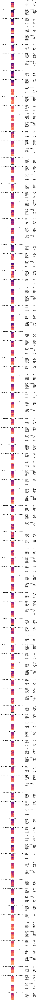

In [107]:
generate_output_report(output_data = processed_error_array_sorted,
                      output_image_data = error_img_data,
                      model_name = "base_model_3_8_2023_sigmoid-try11-siren",
                      report_type = "error")



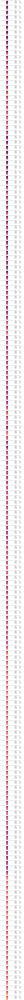

In [108]:
generate_output_report(output_data = processed_success_array_sorted,
                      output_image_data = success_img_data,
                      model_name = "base_model_3_8_2023_sigmoid-try11-siren",
                      report_type = "success")

In [ ]:
# PLT multiple axis tutorial:
# https://matplotlib.org/stable/gallery/subplots_axes_and_figures/subplots_demo.html

In [21]:
# https://stackoverflow.com/questions/54495612/numpy-get-index-of-row-with-second-largest-value
